# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [222]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

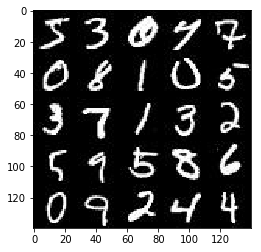

In [223]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

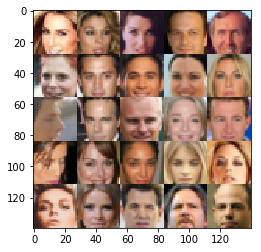

In [224]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [225]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


/Users/kochiai/anaconda/envs/cnn_udacity/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.
  


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [234]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    print(image_width)
    print(image_height)
    print(image_channels)
    print(z_dim)


    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    
    # TODO: Implement Function
    input_real = tf.placeholder(dtype=tf.float32, shape=(None, image_width, image_height, image_channels),name='input_real')
    input_z = tf.placeholder(dtype=tf.float32, shape=(None, z_dim), name='input_z')
    learning_rate = tf.placeholder(dtype=tf.float16, name='learning_rate')
    return input_real, input_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

28
28
3
100
Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [249]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        # TODO: Implement Function
        # Conv1 - 28x28x3
        conv1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        #batch_norm1 = tf.layers.batch_normalization(conv1, training=True)
        leaky_relu1 = tf.maximum(alpha*conv1, conv1) 
        
        # Conv2 - 14x14x128
        conv2 = tf.layers.conv2d(leaky_relu1, 128, 5, strides=2, padding='same')
        batch_norm2 = tf.layers.batch_normalization(conv2, training=True)
        leaky_relu2 = tf.maximum(alpha*batch_norm2, batch_norm2) 

        # Conv3 - 7x7x256
        conv3 = tf.layers.conv2d(leaky_relu2, 256, 5, strides=1, padding='same')
        batch_norm3 = tf.layers.batch_normalization(conv3, training=True)
        leaky_relu3 = tf.maximum(alpha*batch_norm3, batch_norm3) 

#         # Conv3 - 3x3x512
#         conv4 = tf.layers.conv2d(inputs=leaky_relu3, filters=1024, kernel_size=5, strides=2, padding='same', activation=None)
#         batch_norm3 = tf.layers.batch_normalization(conv3, training=True)
#         leaky_relu3 = tf.maximum(alpha*batch_norm3, batch_norm3) 
     
        # 1x1x1024
        flat = tf.reshape(leaky_relu3, (-1, 7*7*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [250]:
##### import problem_unittests


def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """        
    with tf.variable_scope('generator', reuse= not is_train ):
        x = tf.layers.dense(z, 7*7*256, activation=None)
        # Reshape 1 dimentional array into 4x4x512 for each input
        x = tf.reshape(x, (-1, 7, 7, 256))
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha*x, x)
            
        # conv2d_transpose1 into 7x7x256
        conv1_t = tf.layers.conv2d_transpose(x, 
                                             128, 
                                             5, 
                                             strides=1,
                                             padding='same')
        # 14x14x512
        conv1_t_bn = tf.layers.batch_normalization(conv1_t, training=is_train)
        conv1_t_relu = tf.maximum(alpha*conv1_t_bn, conv1_t_bn)
        
        
        # conv2d_transpose2 into 14x14x128
        conv2_t = tf.layers.conv2d_transpose(conv1_t_relu, 
                                             128, 
                                             5, 
                                             strides=2, 
                                             padding='same')
        conv2_t_bn = tf.layers.batch_normalization(conv2_t, training=is_train)
        conv2_t_relu = tf.maximum(alpha*conv2_t_bn, conv2_t_bn)
            
#         # conv2d_transpose1 into 12x12x128
#         conv3_t = tf.layers.conv2d_transpose(inputs=conv2_t_relu, 
#                                              filters=256, 
#                                              kernel_size=5, 
#                                              strides=2, 
#                                              padding='same', 
#                                              activation=None)
#         conv3_t_bn = tf.layers.batch_normalization(conv3_t, training=is_train)
#         conv3_t_relu = tf.maximum(alpha*conv3_t_bn, conv3_t_bn)
        
        # conv2d_transpose into 28 x 28 x out_channel_dim
        # tanh
        logits = tf.layers.conv2d_transpose(conv2_t_relu, 
                                            out_channel_dim, 
                                            5, 
                                            strides=2, 
                                            padding='same')
        out = tf.tanh(logits)
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [251]:
def model_loss(input_real, input_z, out_channel_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    generator_out = generator(z=input_z, out_channel_dim=out_channel_dim, is_train=True, alpha=alpha)
    d_model_real, d_logits_real = discriminator(images=input_real, reuse=False, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(images=generator_out, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real))
    )
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake))
    )
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake))
    )
    
    d_loss = d_loss_real + d_loss_fake
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [252]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [253]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [257]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode, print_every=1):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    print(learning_rate)
    # Build Model
    tf.reset_default_graph()
    #def model_inputs(image_width, image_height, image_channels, z_dim):

    print(data_shape)
    input_real, input_z, lr = model_inputs(data_shape[1],
                                         data_shape[2],
                                         data_shape[3],
                                         z_dim)
    
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3], 0.2)
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    
    saver = tf.train.Saver()
    #72 images
    sample_z = np.random.uniform(-1, 1, size=(72, *data_shape[1:]))

    samples, losses = [], []
    steps = 0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                batch_images = batch_images * 2
                # TODO: Train Model
                steps += 1
                 # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                 # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, 
                                               input_z: batch_z, 
                                               lr:learning_rate})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, 
                                               input_real: batch_images,
                                               lr:learning_rate})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                    _ = show_generator_output(sess, 72, input_z, data_shape[3], data_image_mode)


                    #plt.show()
        
        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples         

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

(60000, 28, 28, 1)
0.0002
(60000, 28, 28, 1)
28
28
1
100
Epoch 1/2... Discriminator Loss: 3.0606... Generator Loss: 0.0643


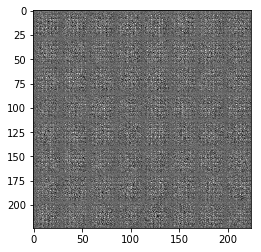

Epoch 1/2... Discriminator Loss: 2.0343... Generator Loss: 0.4877


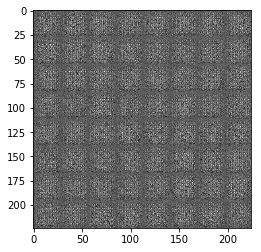

Epoch 1/2... Discriminator Loss: 2.8520... Generator Loss: 0.0775


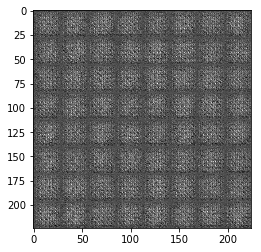

Epoch 1/2... Discriminator Loss: 2.4998... Generator Loss: 2.3517


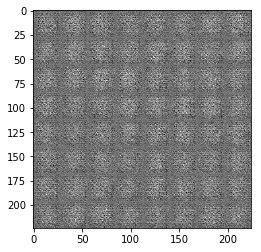

Epoch 1/2... Discriminator Loss: 3.4133... Generator Loss: 0.0396


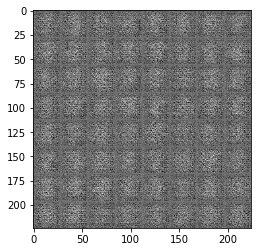

Epoch 1/2... Discriminator Loss: 1.1030... Generator Loss: 1.0379


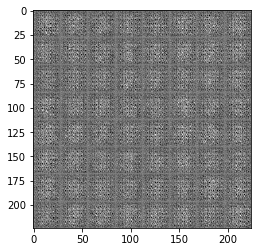

Epoch 1/2... Discriminator Loss: 1.8845... Generator Loss: 0.2428


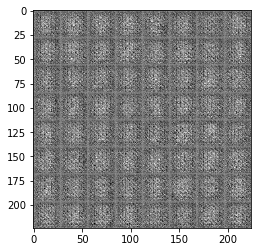

Epoch 1/2... Discriminator Loss: 2.4669... Generator Loss: 2.8682


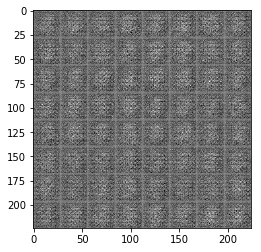

Epoch 1/2... Discriminator Loss: 3.9628... Generator Loss: 0.0247


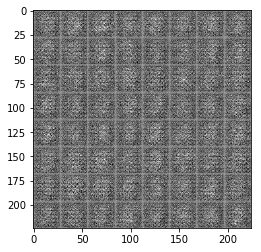

Epoch 1/2... Discriminator Loss: 1.5128... Generator Loss: 1.7512


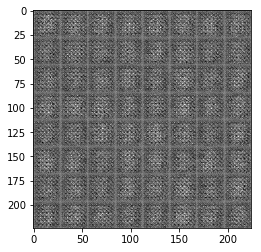

Epoch 1/2... Discriminator Loss: 2.8551... Generator Loss: 0.0722


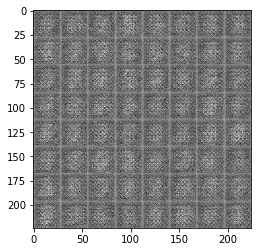

Epoch 1/2... Discriminator Loss: 3.1418... Generator Loss: 3.5622


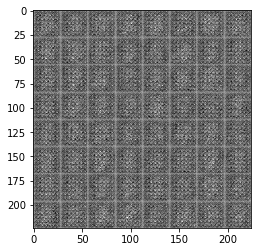

Epoch 1/2... Discriminator Loss: 3.2008... Generator Loss: 0.0509


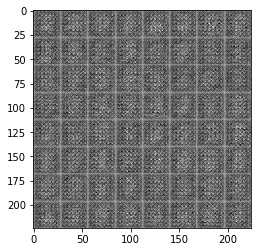

Epoch 1/2... Discriminator Loss: 1.8849... Generator Loss: 2.5033


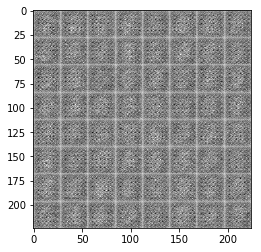

Epoch 1/2... Discriminator Loss: 2.7633... Generator Loss: 0.0768


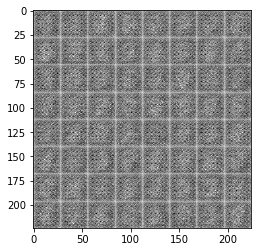

Epoch 1/2... Discriminator Loss: 2.5374... Generator Loss: 3.0955


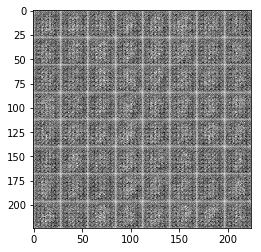

Epoch 1/2... Discriminator Loss: 2.9219... Generator Loss: 0.0681


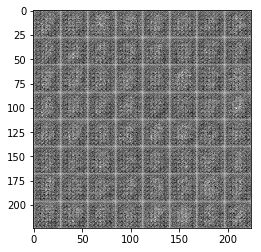

Epoch 1/2... Discriminator Loss: 2.4297... Generator Loss: 3.3199


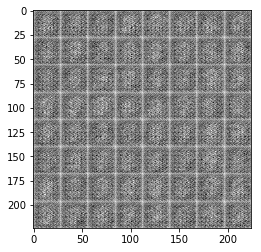

Epoch 1/2... Discriminator Loss: 2.6775... Generator Loss: 0.0824


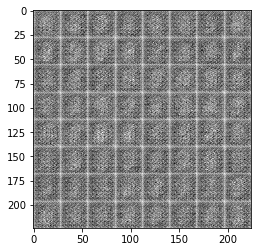

Epoch 1/2... Discriminator Loss: 2.4770... Generator Loss: 4.0978


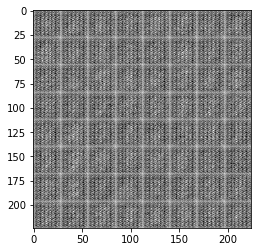

Epoch 1/2... Discriminator Loss: 2.4205... Generator Loss: 0.1084


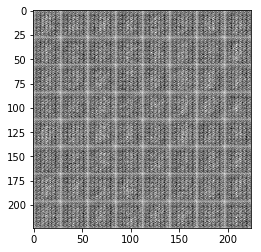

Epoch 1/2... Discriminator Loss: 2.1683... Generator Loss: 3.3485


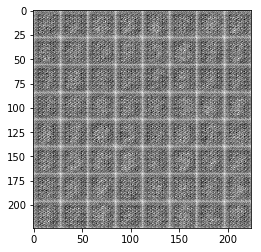

Epoch 1/2... Discriminator Loss: 2.3087... Generator Loss: 0.1236


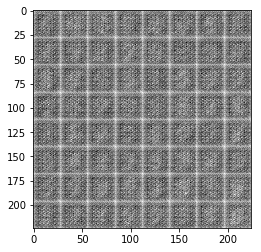

Epoch 1/2... Discriminator Loss: 1.7364... Generator Loss: 3.5494


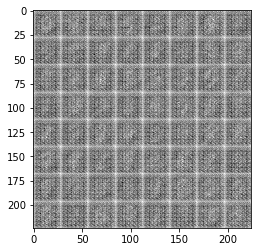

Epoch 1/2... Discriminator Loss: 2.3033... Generator Loss: 0.1275


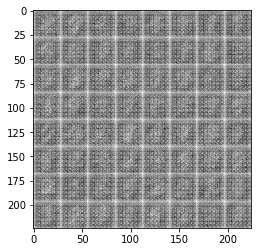

Epoch 1/2... Discriminator Loss: 2.2486... Generator Loss: 3.6109


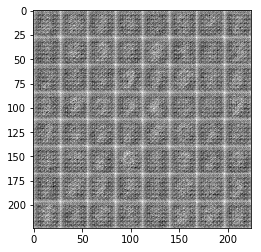

Epoch 1/2... Discriminator Loss: 2.2072... Generator Loss: 0.1456


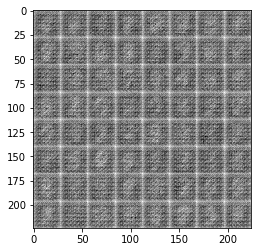

Epoch 1/2... Discriminator Loss: 2.2534... Generator Loss: 3.7725


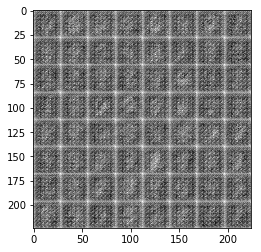

Epoch 1/2... Discriminator Loss: 2.2462... Generator Loss: 0.1365


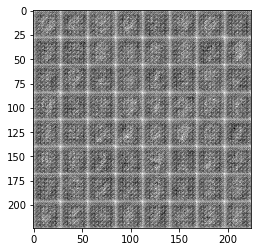

Epoch 1/2... Discriminator Loss: 1.9993... Generator Loss: 3.6844


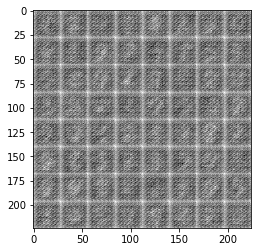

Epoch 1/2... Discriminator Loss: 1.9394... Generator Loss: 0.1964


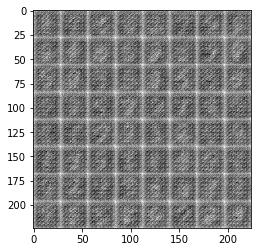

Epoch 1/2... Discriminator Loss: 1.7086... Generator Loss: 2.9849


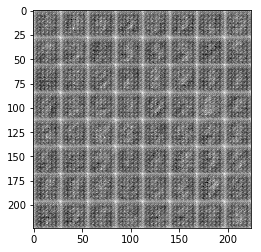

Epoch 1/2... Discriminator Loss: 2.1457... Generator Loss: 0.1611


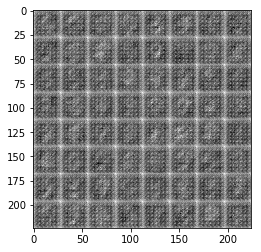

Epoch 1/2... Discriminator Loss: 1.9366... Generator Loss: 3.1615


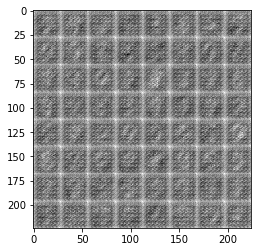

Epoch 1/2... Discriminator Loss: 1.9135... Generator Loss: 0.2044


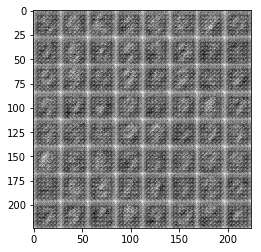

Epoch 1/2... Discriminator Loss: 1.6134... Generator Loss: 2.9092


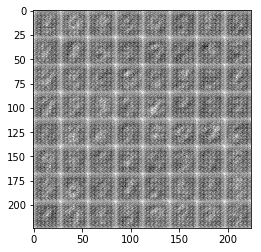

Epoch 1/2... Discriminator Loss: 1.9747... Generator Loss: 0.2025


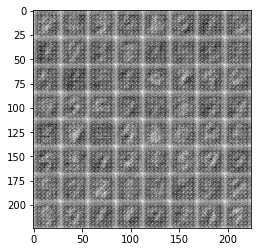

Epoch 1/2... Discriminator Loss: 1.8364... Generator Loss: 2.7744


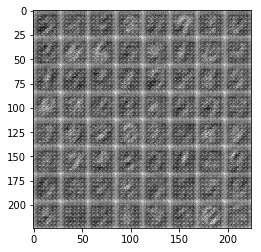

Epoch 1/2... Discriminator Loss: 1.9884... Generator Loss: 0.1934


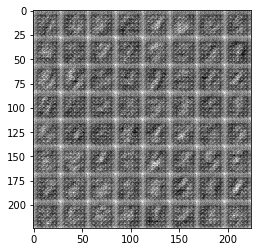

Epoch 1/2... Discriminator Loss: 1.6197... Generator Loss: 2.5592


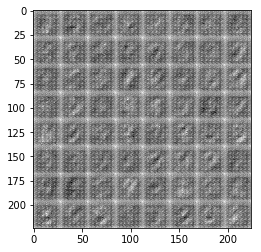

Epoch 1/2... Discriminator Loss: 1.8230... Generator Loss: 0.2427


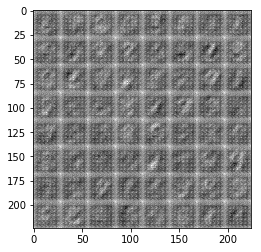

Epoch 1/2... Discriminator Loss: 1.7277... Generator Loss: 2.2393


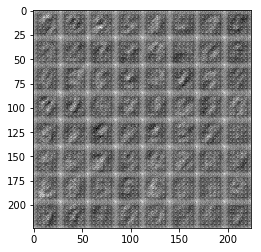

Epoch 1/2... Discriminator Loss: 1.8883... Generator Loss: 0.2176


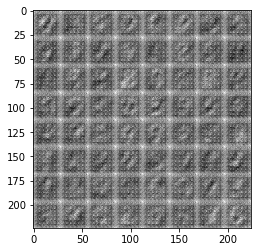

Epoch 1/2... Discriminator Loss: 1.6487... Generator Loss: 2.2668


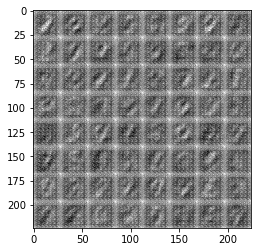

Epoch 1/2... Discriminator Loss: 1.8601... Generator Loss: 0.2235


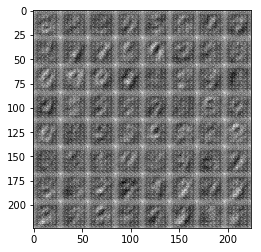

Epoch 1/2... Discriminator Loss: 1.7277... Generator Loss: 2.4489


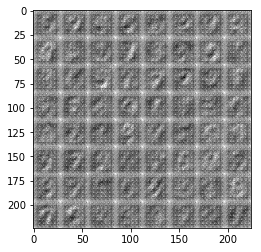

Epoch 1/2... Discriminator Loss: 2.0219... Generator Loss: 0.1970


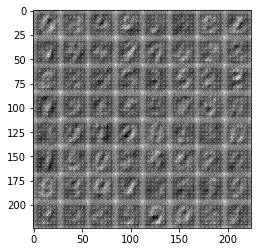

Epoch 1/2... Discriminator Loss: 1.6349... Generator Loss: 2.3380


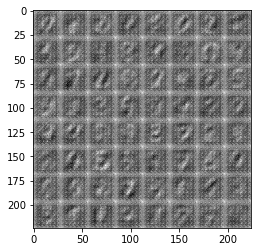

Epoch 1/2... Discriminator Loss: 1.8113... Generator Loss: 0.2637


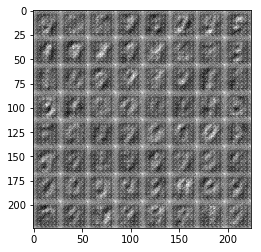

Epoch 1/2... Discriminator Loss: 1.6448... Generator Loss: 2.4224


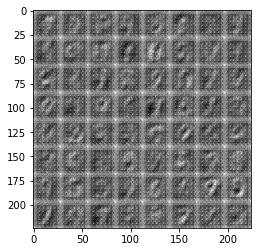

Epoch 1/2... Discriminator Loss: 1.9343... Generator Loss: 0.2048


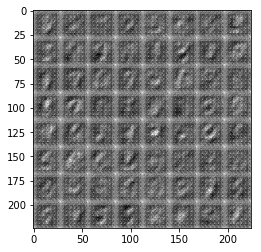

Epoch 1/2... Discriminator Loss: 1.8091... Generator Loss: 2.3695


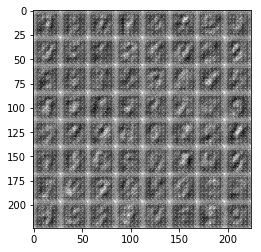

Epoch 1/2... Discriminator Loss: 1.8851... Generator Loss: 0.2144


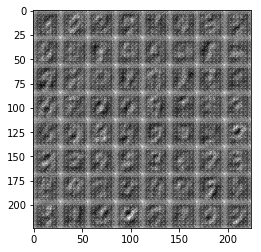

Epoch 1/2... Discriminator Loss: 1.7502... Generator Loss: 2.2224


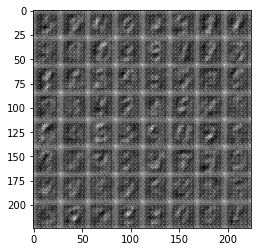

Epoch 1/2... Discriminator Loss: 2.0012... Generator Loss: 0.2075


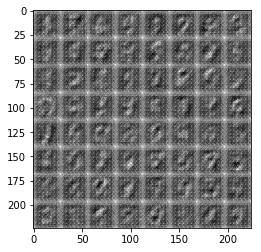

Epoch 1/2... Discriminator Loss: 1.6941... Generator Loss: 2.1516


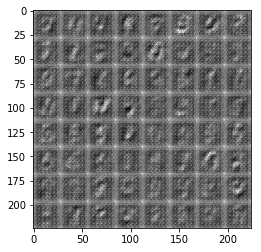

Epoch 1/2... Discriminator Loss: 1.9568... Generator Loss: 0.1975


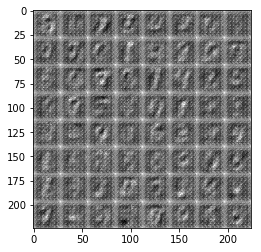

Epoch 1/2... Discriminator Loss: 1.6888... Generator Loss: 2.4976


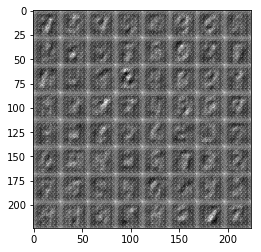

Epoch 1/2... Discriminator Loss: 1.8820... Generator Loss: 0.2124


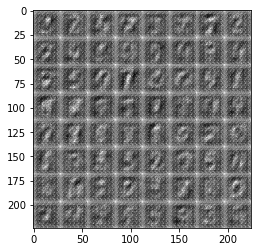

Epoch 1/2... Discriminator Loss: 1.7768... Generator Loss: 2.3147


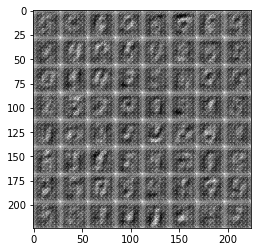

Epoch 1/2... Discriminator Loss: 1.8952... Generator Loss: 0.2171


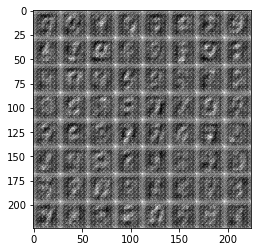

Epoch 1/2... Discriminator Loss: 1.9132... Generator Loss: 2.2425


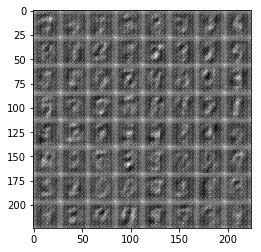

Epoch 1/2... Discriminator Loss: 1.8975... Generator Loss: 0.2087


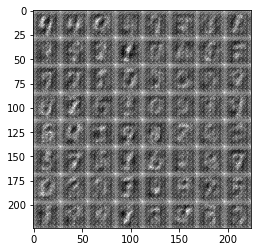

Epoch 1/2... Discriminator Loss: 1.8351... Generator Loss: 2.3090


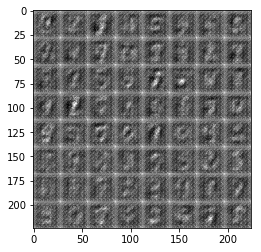

Epoch 1/2... Discriminator Loss: 1.8125... Generator Loss: 0.2618


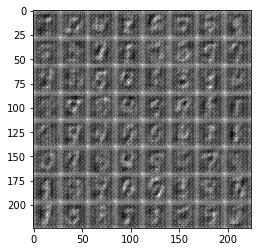

Epoch 1/2... Discriminator Loss: 1.7093... Generator Loss: 1.8928


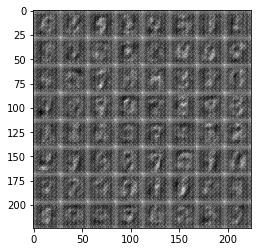

Epoch 1/2... Discriminator Loss: 1.8308... Generator Loss: 0.2293


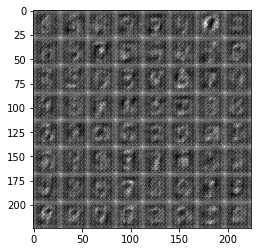

Epoch 1/2... Discriminator Loss: 1.9803... Generator Loss: 2.3997


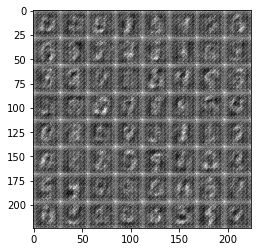

Epoch 1/2... Discriminator Loss: 2.1367... Generator Loss: 0.1683


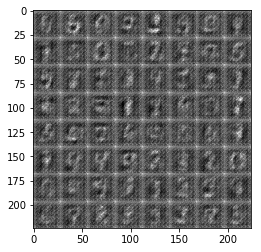

Epoch 1/2... Discriminator Loss: 1.8816... Generator Loss: 2.2158


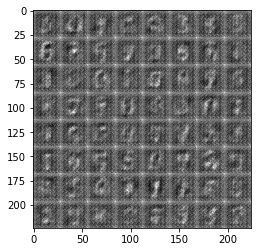

Epoch 1/2... Discriminator Loss: 1.8611... Generator Loss: 0.2320


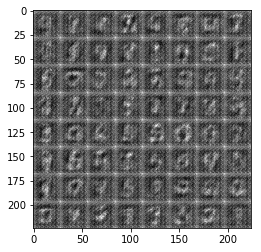

Epoch 1/2... Discriminator Loss: 1.9061... Generator Loss: 2.3323


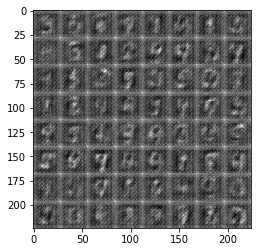

Epoch 1/2... Discriminator Loss: 1.7381... Generator Loss: 0.2635


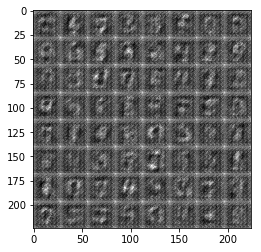

Epoch 1/2... Discriminator Loss: 1.6715... Generator Loss: 2.0230


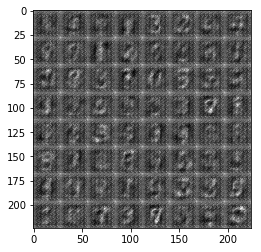

Epoch 1/2... Discriminator Loss: 1.5563... Generator Loss: 0.3249


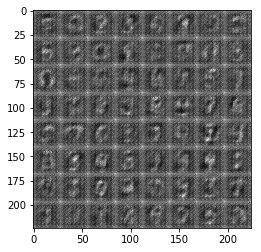

Epoch 1/2... Discriminator Loss: 1.5797... Generator Loss: 1.8100


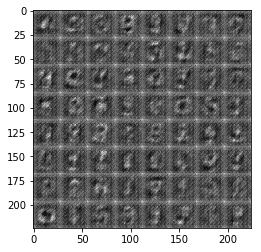

Epoch 1/2... Discriminator Loss: 1.6575... Generator Loss: 0.2821


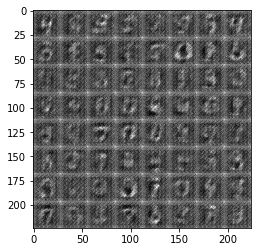

Epoch 1/2... Discriminator Loss: 1.5309... Generator Loss: 1.8425


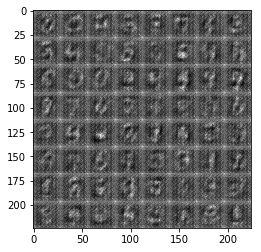

Epoch 1/2... Discriminator Loss: 1.5311... Generator Loss: 0.3176


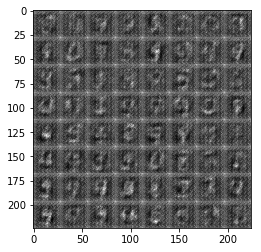

Epoch 1/2... Discriminator Loss: 1.5154... Generator Loss: 1.9136


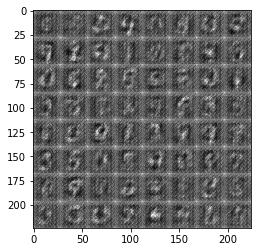

Epoch 1/2... Discriminator Loss: 1.6664... Generator Loss: 0.2680


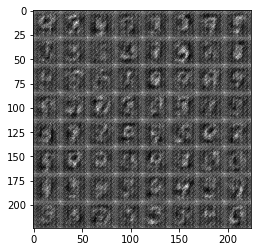

Epoch 1/2... Discriminator Loss: 1.5519... Generator Loss: 1.9897


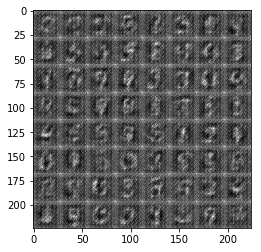

Epoch 1/2... Discriminator Loss: 1.7480... Generator Loss: 0.2671


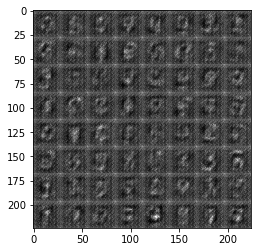

Epoch 1/2... Discriminator Loss: 1.5362... Generator Loss: 1.9831


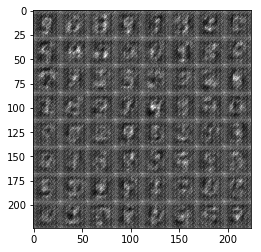

Epoch 1/2... Discriminator Loss: 1.7687... Generator Loss: 0.2403


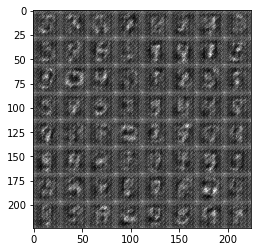

Epoch 1/2... Discriminator Loss: 1.6577... Generator Loss: 2.1119


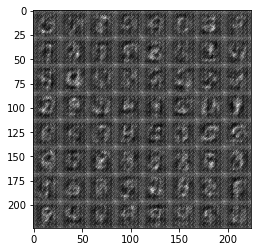

Epoch 1/2... Discriminator Loss: 1.5318... Generator Loss: 0.3162


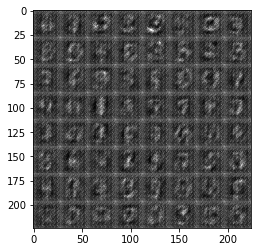

Epoch 1/2... Discriminator Loss: 1.5543... Generator Loss: 2.0354


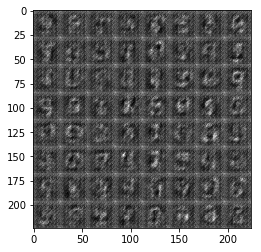

Epoch 1/2... Discriminator Loss: 1.7427... Generator Loss: 0.2522


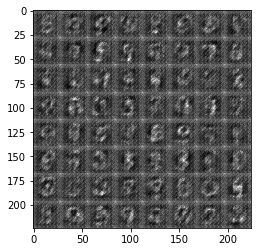

Epoch 1/2... Discriminator Loss: 1.5002... Generator Loss: 2.0273


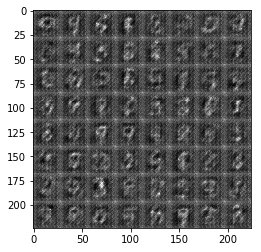

Epoch 1/2... Discriminator Loss: 1.5840... Generator Loss: 0.3146


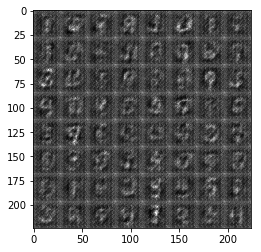

Epoch 1/2... Discriminator Loss: 1.4732... Generator Loss: 1.8751


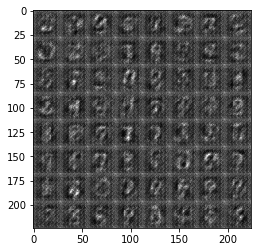

Epoch 1/2... Discriminator Loss: 1.5947... Generator Loss: 0.3131


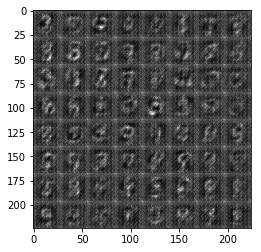

Epoch 1/2... Discriminator Loss: 1.4105... Generator Loss: 1.9773


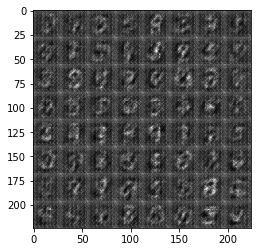

Epoch 1/2... Discriminator Loss: 1.4502... Generator Loss: 0.3677


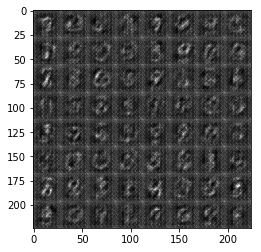

Epoch 1/2... Discriminator Loss: 1.4109... Generator Loss: 1.8034


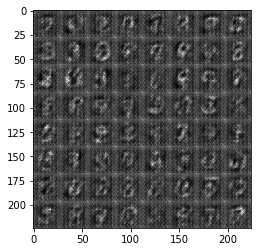

Epoch 1/2... Discriminator Loss: 1.6089... Generator Loss: 0.2922


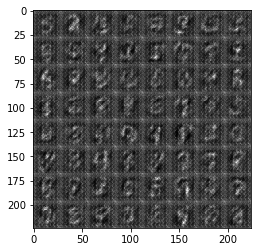

Epoch 1/2... Discriminator Loss: 1.6103... Generator Loss: 1.9639


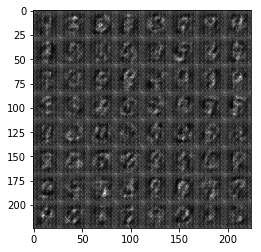

Epoch 1/2... Discriminator Loss: 1.8035... Generator Loss: 0.2301


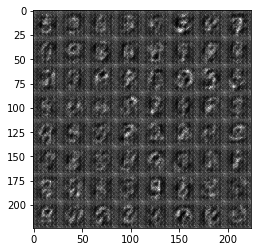

Epoch 1/2... Discriminator Loss: 1.5151... Generator Loss: 2.0380


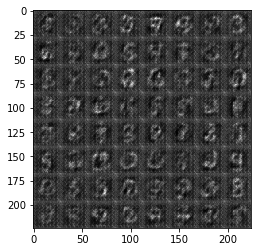

Epoch 1/2... Discriminator Loss: 1.5859... Generator Loss: 0.3032


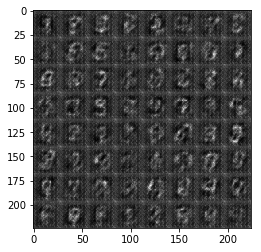

Epoch 1/2... Discriminator Loss: 1.4707... Generator Loss: 1.8150


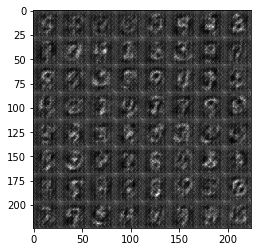

Epoch 1/2... Discriminator Loss: 1.4055... Generator Loss: 0.3961


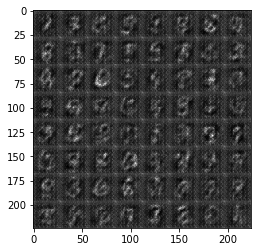

Epoch 1/2... Discriminator Loss: 1.3599... Generator Loss: 1.8392


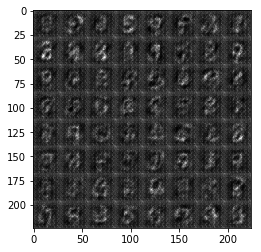

Epoch 1/2... Discriminator Loss: 1.4165... Generator Loss: 0.3615


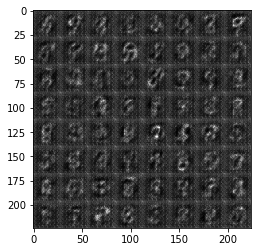

Epoch 1/2... Discriminator Loss: 1.3925... Generator Loss: 1.9108


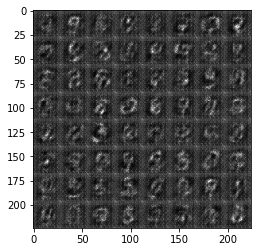

Epoch 1/2... Discriminator Loss: 1.4593... Generator Loss: 0.3394


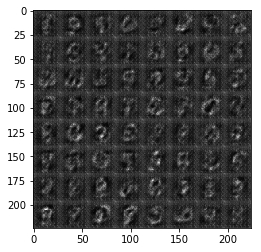

Epoch 1/2... Discriminator Loss: 1.3576... Generator Loss: 1.9193


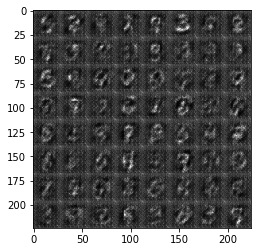

Epoch 1/2... Discriminator Loss: 1.5711... Generator Loss: 0.3165


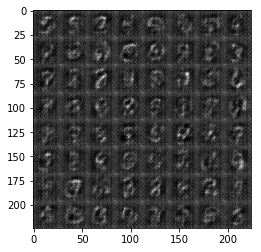

Epoch 1/2... Discriminator Loss: 1.5097... Generator Loss: 1.9147


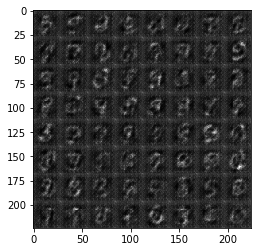

Epoch 1/2... Discriminator Loss: 1.5790... Generator Loss: 0.3147


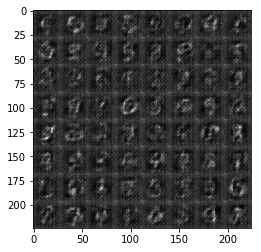

Epoch 1/2... Discriminator Loss: 1.4040... Generator Loss: 1.9364


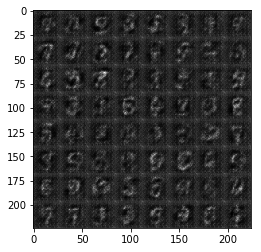

Epoch 1/2... Discriminator Loss: 1.4683... Generator Loss: 0.3520


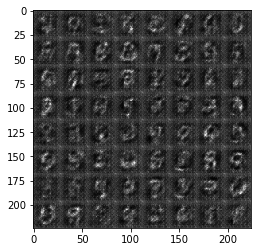

Epoch 1/2... Discriminator Loss: 1.3454... Generator Loss: 1.8251


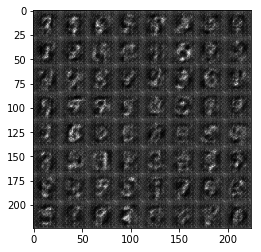

Epoch 1/2... Discriminator Loss: 1.3545... Generator Loss: 0.3754


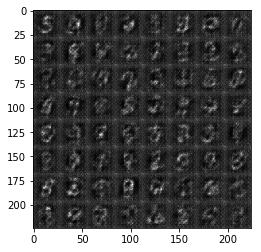

Epoch 1/2... Discriminator Loss: 1.3255... Generator Loss: 1.7437


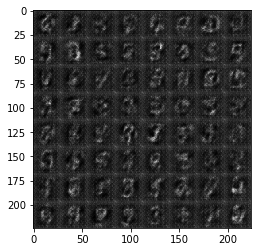

Epoch 1/2... Discriminator Loss: 1.4689... Generator Loss: 0.3622


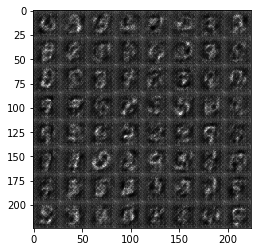

Epoch 1/2... Discriminator Loss: 1.3301... Generator Loss: 1.6851


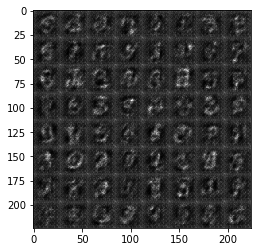

Epoch 1/2... Discriminator Loss: 1.3982... Generator Loss: 0.3857


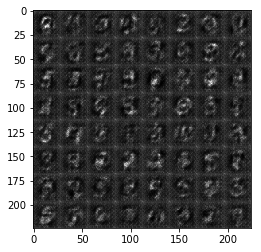

Epoch 1/2... Discriminator Loss: 1.3786... Generator Loss: 1.8816


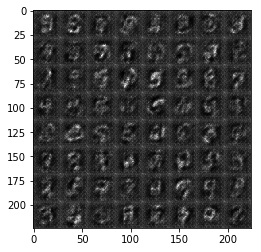

Epoch 1/2... Discriminator Loss: 1.4498... Generator Loss: 0.3668


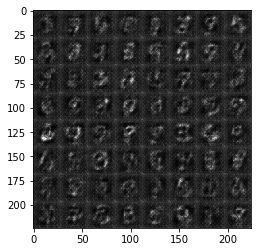

Epoch 1/2... Discriminator Loss: 1.3580... Generator Loss: 1.8854


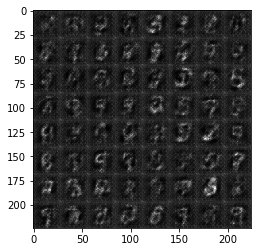

Epoch 1/2... Discriminator Loss: 1.4378... Generator Loss: 0.3511


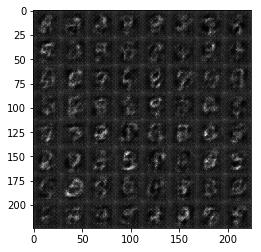

Epoch 1/2... Discriminator Loss: 1.3525... Generator Loss: 1.9454


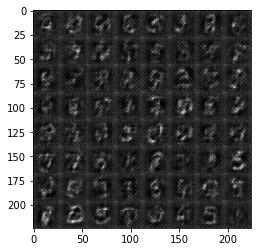

Epoch 1/2... Discriminator Loss: 1.5214... Generator Loss: 0.3255


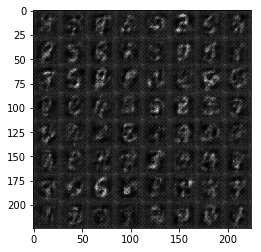

Epoch 1/2... Discriminator Loss: 1.3606... Generator Loss: 1.9108


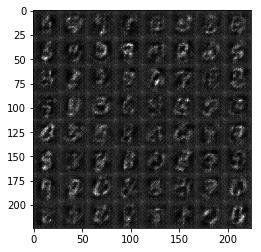

Epoch 1/2... Discriminator Loss: 1.4934... Generator Loss: 0.3400


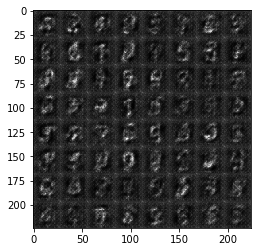

Epoch 1/2... Discriminator Loss: 1.3675... Generator Loss: 2.0295


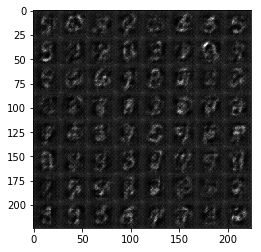

Epoch 1/2... Discriminator Loss: 1.4283... Generator Loss: 0.3614


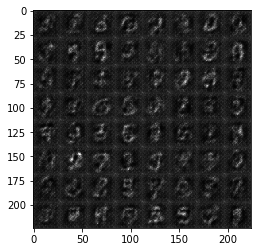

Epoch 1/2... Discriminator Loss: 1.3239... Generator Loss: 1.9025


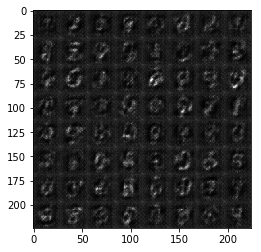

Epoch 1/2... Discriminator Loss: 1.1633... Generator Loss: 0.5451


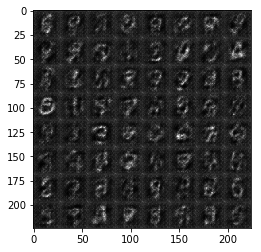

Epoch 1/2... Discriminator Loss: 1.1797... Generator Loss: 1.5513


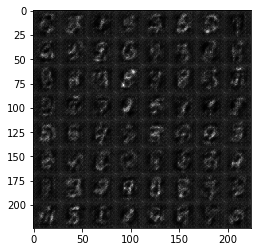

Epoch 1/2... Discriminator Loss: 1.2375... Generator Loss: 0.4706


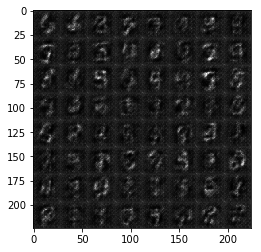

Epoch 1/2... Discriminator Loss: 1.3104... Generator Loss: 1.7627


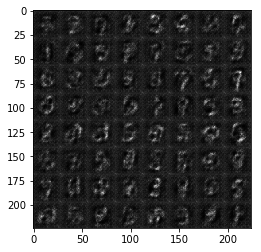

Epoch 1/2... Discriminator Loss: 1.2899... Generator Loss: 0.4210


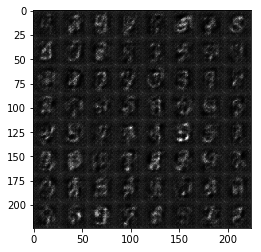

Epoch 1/2... Discriminator Loss: 1.2829... Generator Loss: 1.9150


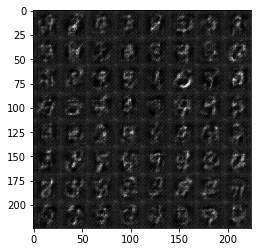

Epoch 1/2... Discriminator Loss: 1.3204... Generator Loss: 0.4113


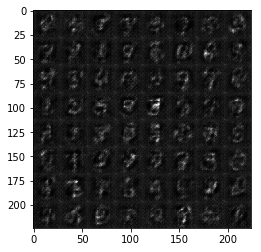

Epoch 1/2... Discriminator Loss: 1.3608... Generator Loss: 1.9881


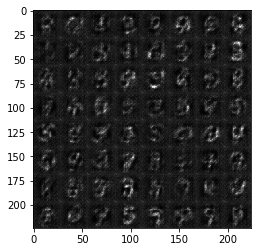

Epoch 1/2... Discriminator Loss: 1.4728... Generator Loss: 0.3264


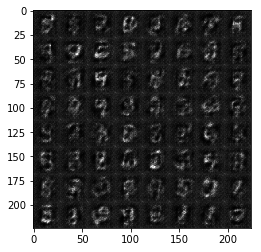

Epoch 1/2... Discriminator Loss: 1.3544... Generator Loss: 2.1597


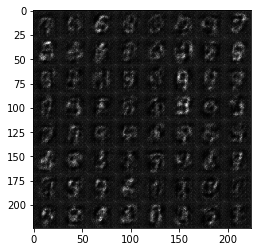

Epoch 1/2... Discriminator Loss: 1.5090... Generator Loss: 0.3233


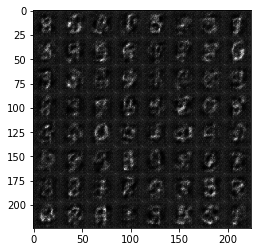

Epoch 1/2... Discriminator Loss: 1.3674... Generator Loss: 2.1034


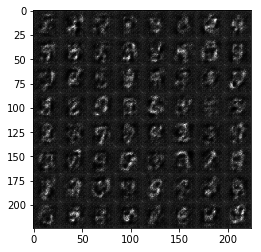

Epoch 1/2... Discriminator Loss: 1.5003... Generator Loss: 0.3273


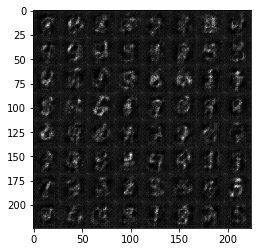

Epoch 1/2... Discriminator Loss: 1.3662... Generator Loss: 2.1163


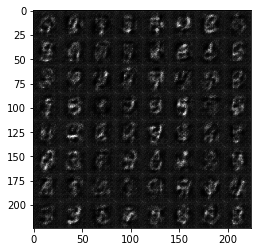

Epoch 1/2... Discriminator Loss: 1.4560... Generator Loss: 0.3370


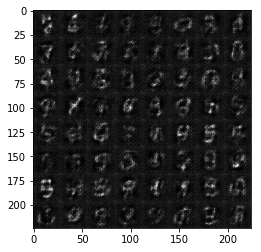

Epoch 1/2... Discriminator Loss: 1.3419... Generator Loss: 2.0216


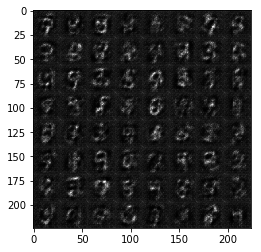

Epoch 1/2... Discriminator Loss: 1.3315... Generator Loss: 0.3994


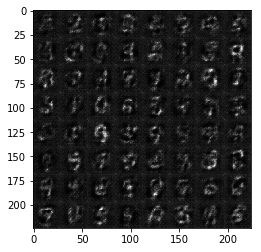

Epoch 1/2... Discriminator Loss: 1.1590... Generator Loss: 1.8014


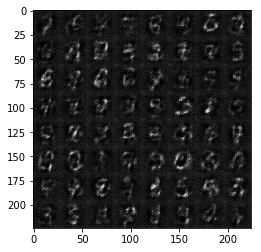

Epoch 1/2... Discriminator Loss: 1.2376... Generator Loss: 0.4494


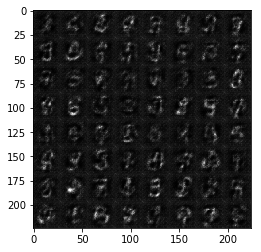

Epoch 1/2... Discriminator Loss: 1.1952... Generator Loss: 1.7545


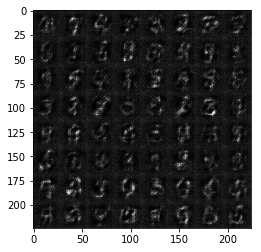

Epoch 1/2... Discriminator Loss: 1.2154... Generator Loss: 0.4825


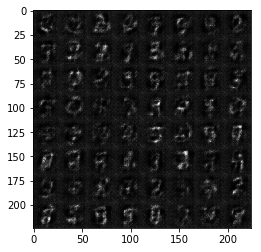

Epoch 1/2... Discriminator Loss: 1.1784... Generator Loss: 1.8047


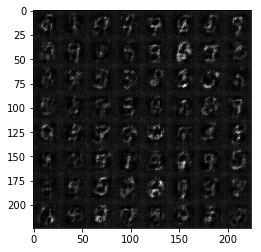

Epoch 1/2... Discriminator Loss: 1.3318... Generator Loss: 0.4026


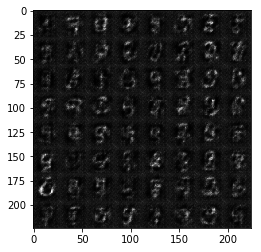

Epoch 1/2... Discriminator Loss: 1.1668... Generator Loss: 1.8903


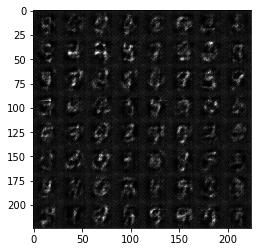

Epoch 1/2... Discriminator Loss: 1.2687... Generator Loss: 0.4402


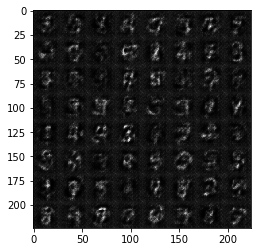

Epoch 1/2... Discriminator Loss: 1.1984... Generator Loss: 1.9235


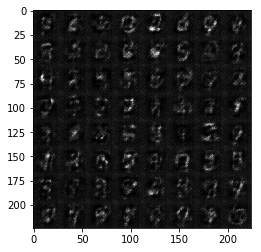

Epoch 1/2... Discriminator Loss: 1.2304... Generator Loss: 0.4645


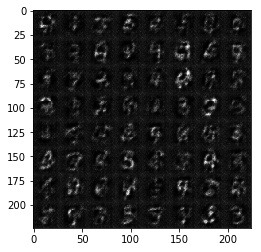

Epoch 1/2... Discriminator Loss: 1.1696... Generator Loss: 1.8676


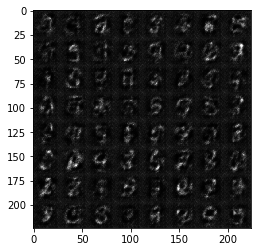

Epoch 1/2... Discriminator Loss: 1.2677... Generator Loss: 0.4312


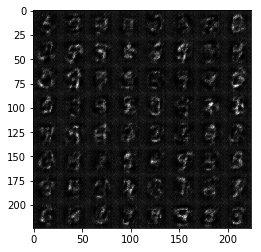

Epoch 1/2... Discriminator Loss: 1.2366... Generator Loss: 1.9032


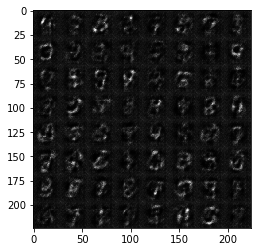

Epoch 1/2... Discriminator Loss: 1.1923... Generator Loss: 0.4686


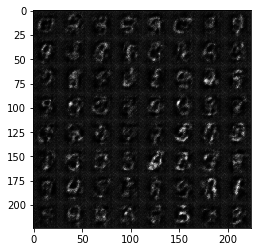

Epoch 1/2... Discriminator Loss: 1.2057... Generator Loss: 1.9719


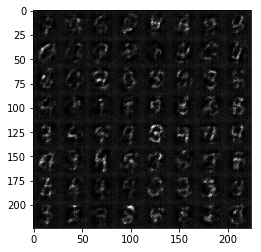

Epoch 1/2... Discriminator Loss: 1.2429... Generator Loss: 0.4364


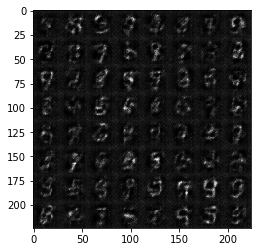

Epoch 1/2... Discriminator Loss: 1.2921... Generator Loss: 1.9674


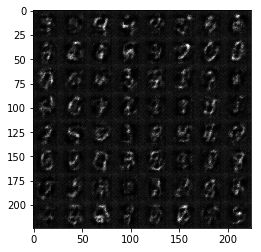

Epoch 1/2... Discriminator Loss: 1.3061... Generator Loss: 0.4101


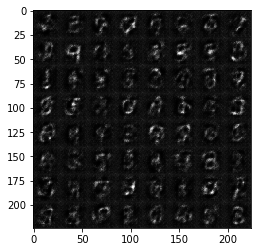

Epoch 1/2... Discriminator Loss: 1.2494... Generator Loss: 2.0721


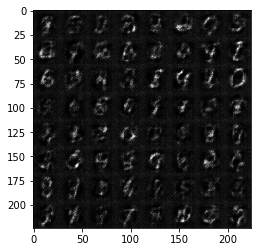

Epoch 1/2... Discriminator Loss: 1.3677... Generator Loss: 0.3765


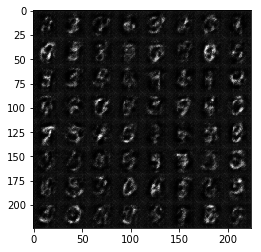

Epoch 1/2... Discriminator Loss: 1.2915... Generator Loss: 2.0186


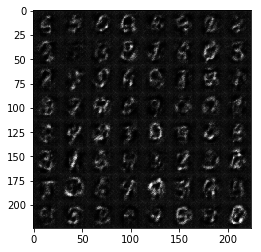

Epoch 1/2... Discriminator Loss: 1.3869... Generator Loss: 0.3687


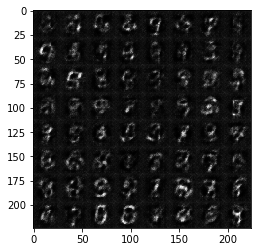

Epoch 1/2... Discriminator Loss: 1.3283... Generator Loss: 2.0917


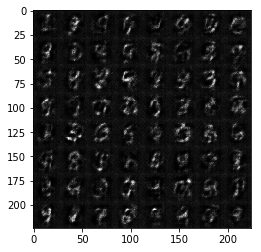

Epoch 1/2... Discriminator Loss: 1.3050... Generator Loss: 0.4146


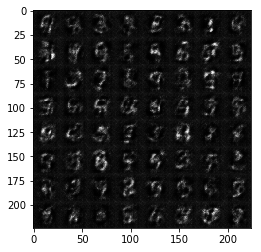

Epoch 1/2... Discriminator Loss: 1.2141... Generator Loss: 1.9036


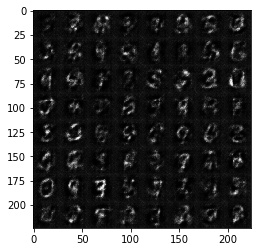

Epoch 1/2... Discriminator Loss: 1.1646... Generator Loss: 0.5094


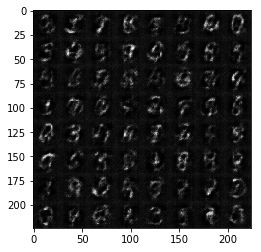

Epoch 1/2... Discriminator Loss: 1.1713... Generator Loss: 2.0002


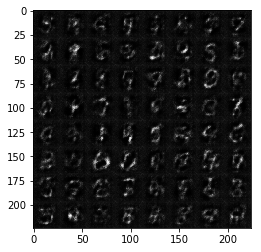

Epoch 1/2... Discriminator Loss: 1.2870... Generator Loss: 0.4094


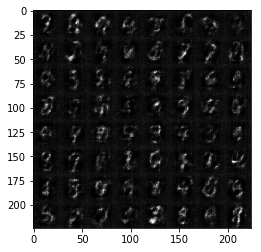

Epoch 1/2... Discriminator Loss: 1.1612... Generator Loss: 1.9946


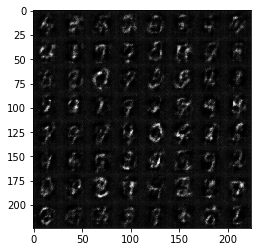

Epoch 1/2... Discriminator Loss: 1.2137... Generator Loss: 0.4737


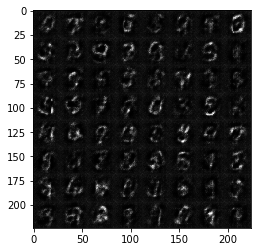

Epoch 1/2... Discriminator Loss: 1.0465... Generator Loss: 1.7631


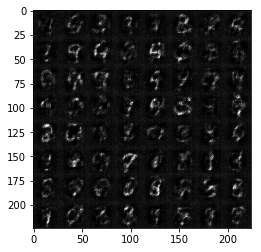

Epoch 1/2... Discriminator Loss: 1.0596... Generator Loss: 0.5769


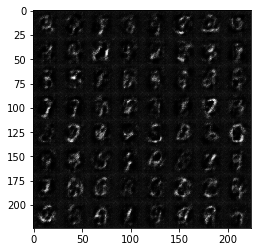

Epoch 1/2... Discriminator Loss: 0.9905... Generator Loss: 1.6422


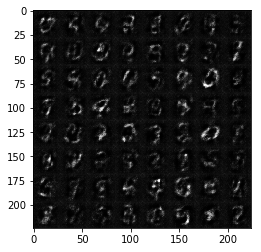

Epoch 1/2... Discriminator Loss: 1.0438... Generator Loss: 0.5814


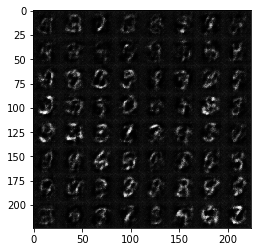

Epoch 1/2... Discriminator Loss: 0.9926... Generator Loss: 1.8704


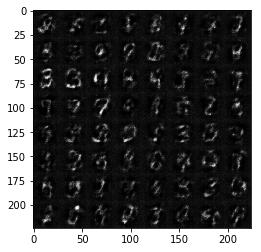

Epoch 1/2... Discriminator Loss: 1.3941... Generator Loss: 0.3732


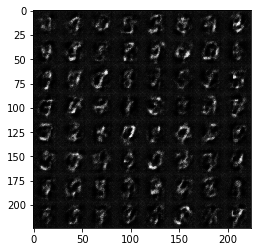

Epoch 1/2... Discriminator Loss: 1.2278... Generator Loss: 2.1510


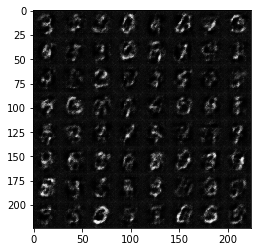

Epoch 1/2... Discriminator Loss: 1.3793... Generator Loss: 0.4353


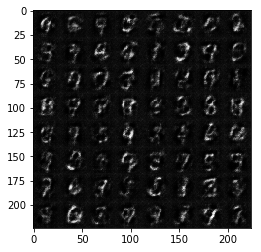

Epoch 1/2... Discriminator Loss: 1.2899... Generator Loss: 1.9683


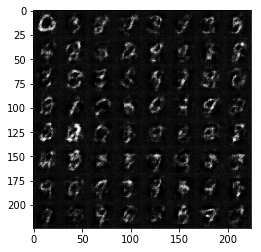

Epoch 1/2... Discriminator Loss: 1.4421... Generator Loss: 0.3624


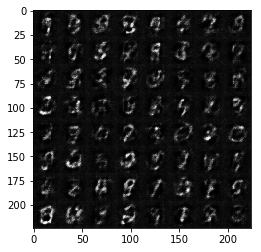

Epoch 1/2... Discriminator Loss: 1.2697... Generator Loss: 2.1848


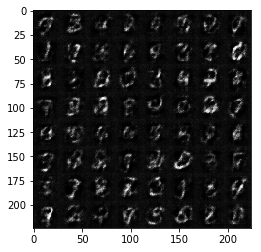

Epoch 1/2... Discriminator Loss: 1.5218... Generator Loss: 0.3221


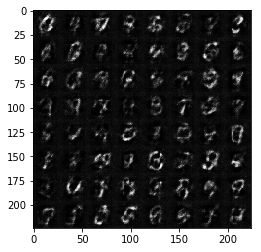

Epoch 1/2... Discriminator Loss: 1.3202... Generator Loss: 2.1066


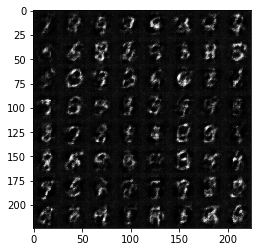

Epoch 1/2... Discriminator Loss: 1.2332... Generator Loss: 0.4486


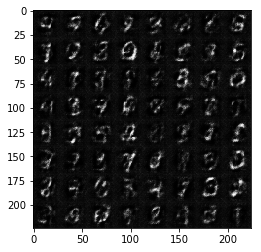

Epoch 1/2... Discriminator Loss: 1.1465... Generator Loss: 1.7710


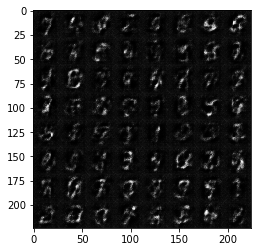

Epoch 1/2... Discriminator Loss: 1.2448... Generator Loss: 0.4621


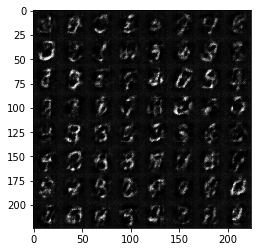

Epoch 1/2... Discriminator Loss: 1.2374... Generator Loss: 1.9138


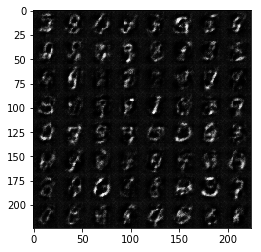

Epoch 1/2... Discriminator Loss: 1.3904... Generator Loss: 0.3665


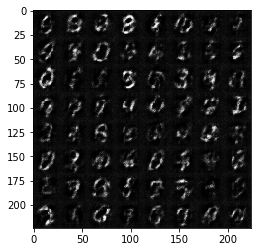

Epoch 1/2... Discriminator Loss: 1.2486... Generator Loss: 2.0154


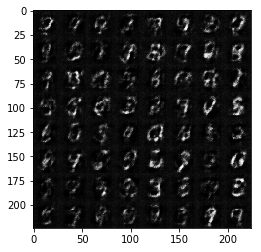

Epoch 1/2... Discriminator Loss: 1.2095... Generator Loss: 0.4649


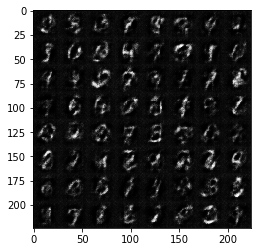

Epoch 1/2... Discriminator Loss: 1.1861... Generator Loss: 2.0049


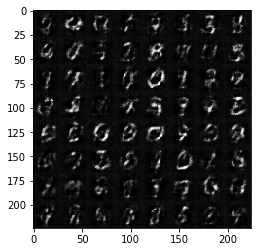

Epoch 1/2... Discriminator Loss: 1.1299... Generator Loss: 0.5327


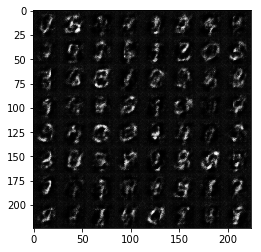

Epoch 1/2... Discriminator Loss: 1.0092... Generator Loss: 1.8221


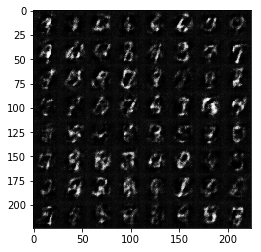

Epoch 2/2... Discriminator Loss: 1.2589... Generator Loss: 0.4420


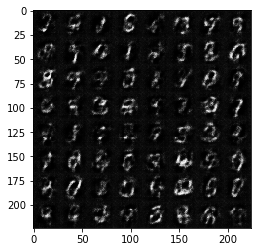

Epoch 2/2... Discriminator Loss: 1.2060... Generator Loss: 2.0384


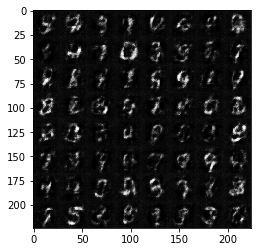

Epoch 2/2... Discriminator Loss: 1.2449... Generator Loss: 0.4281


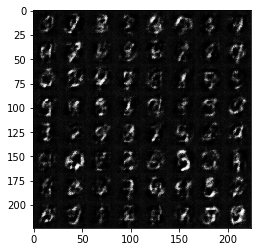

Epoch 2/2... Discriminator Loss: 1.1920... Generator Loss: 2.0032


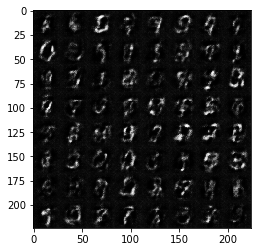

Epoch 2/2... Discriminator Loss: 1.0899... Generator Loss: 0.5269


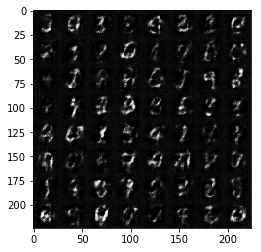

Epoch 2/2... Discriminator Loss: 1.0469... Generator Loss: 1.7362


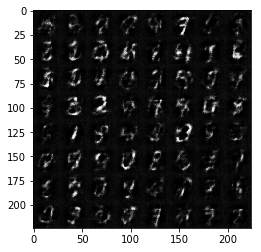

Epoch 2/2... Discriminator Loss: 1.2492... Generator Loss: 0.4499


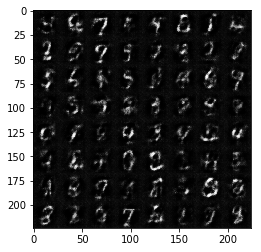

Epoch 2/2... Discriminator Loss: 1.2544... Generator Loss: 1.9926


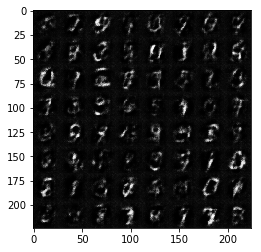

Epoch 2/2... Discriminator Loss: 1.2518... Generator Loss: 0.4625


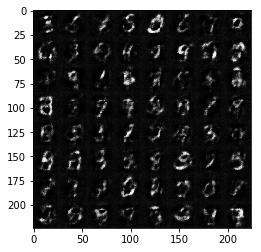

Epoch 2/2... Discriminator Loss: 1.1541... Generator Loss: 1.8474


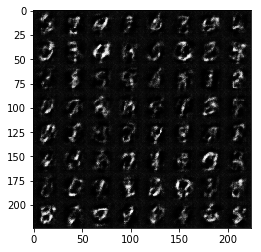

Epoch 2/2... Discriminator Loss: 1.2586... Generator Loss: 0.4325


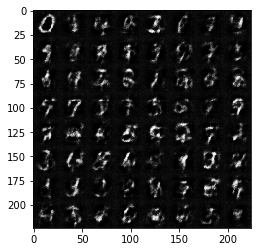

Epoch 2/2... Discriminator Loss: 1.2165... Generator Loss: 1.9475


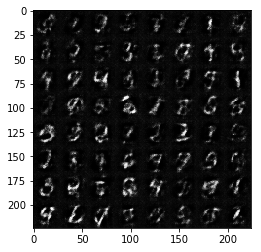

Epoch 2/2... Discriminator Loss: 1.2339... Generator Loss: 0.4548


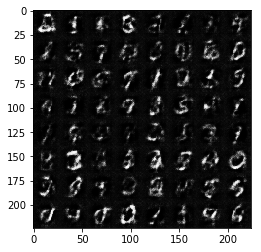

Epoch 2/2... Discriminator Loss: 1.1832... Generator Loss: 1.8831


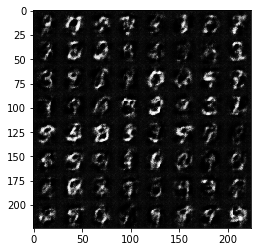

Epoch 2/2... Discriminator Loss: 1.1098... Generator Loss: 0.5183


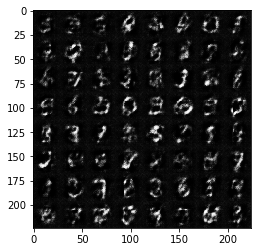

Epoch 2/2... Discriminator Loss: 1.0552... Generator Loss: 1.7911


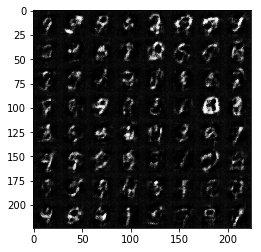

Epoch 2/2... Discriminator Loss: 1.1246... Generator Loss: 0.5160


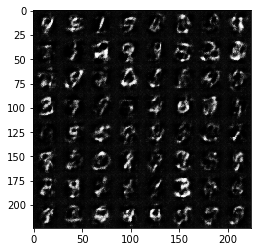

Epoch 2/2... Discriminator Loss: 0.9277... Generator Loss: 1.8314


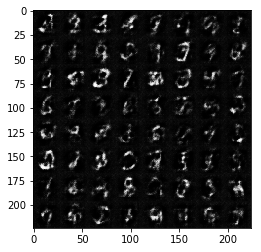

Epoch 2/2... Discriminator Loss: 1.1159... Generator Loss: 0.5140


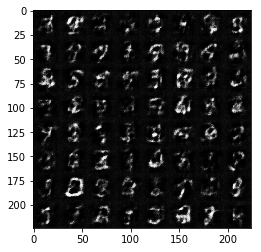

Epoch 2/2... Discriminator Loss: 1.0582... Generator Loss: 1.8843


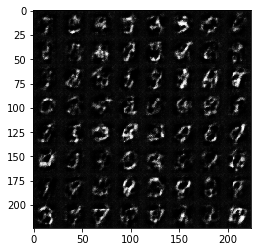

Epoch 2/2... Discriminator Loss: 1.0826... Generator Loss: 0.5249


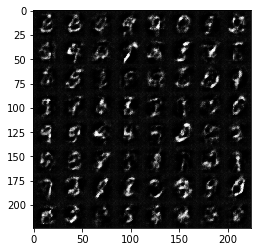

Epoch 2/2... Discriminator Loss: 1.1645... Generator Loss: 1.8093


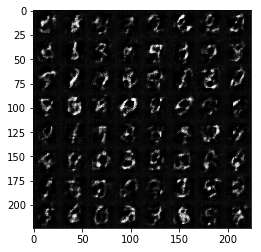

Epoch 2/2... Discriminator Loss: 1.3007... Generator Loss: 0.4230


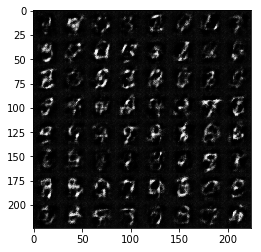

Epoch 2/2... Discriminator Loss: 1.1534... Generator Loss: 2.1191


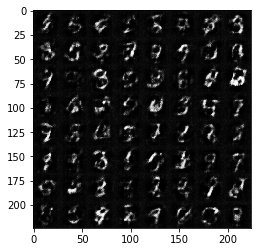

Epoch 2/2... Discriminator Loss: 1.1642... Generator Loss: 0.4879


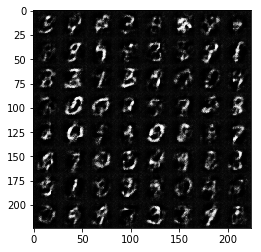

Epoch 2/2... Discriminator Loss: 1.0333... Generator Loss: 1.8024


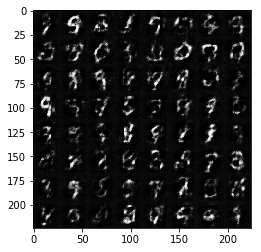

Epoch 2/2... Discriminator Loss: 1.0998... Generator Loss: 0.5476


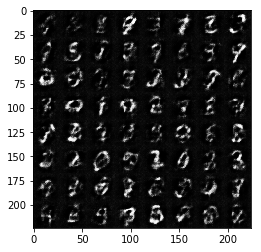

Epoch 2/2... Discriminator Loss: 1.0244... Generator Loss: 1.7787


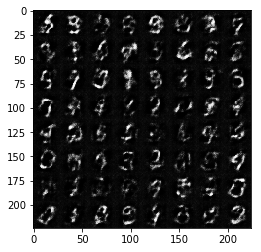

Epoch 2/2... Discriminator Loss: 1.2847... Generator Loss: 0.4184


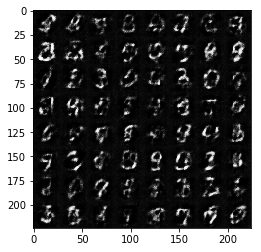

Epoch 2/2... Discriminator Loss: 1.1207... Generator Loss: 2.1137


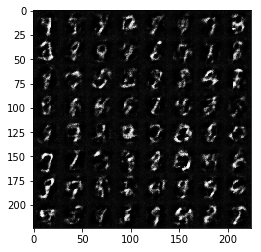

Epoch 2/2... Discriminator Loss: 1.2284... Generator Loss: 0.4458


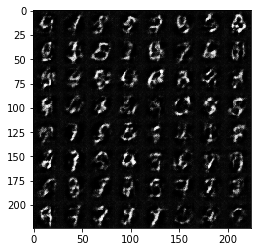

Epoch 2/2... Discriminator Loss: 1.1478... Generator Loss: 2.0314


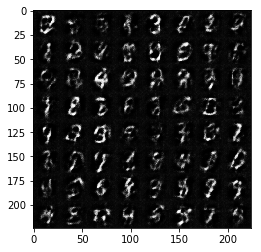

Epoch 2/2... Discriminator Loss: 1.1840... Generator Loss: 0.4769


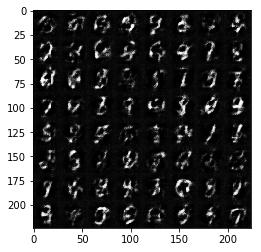

Epoch 2/2... Discriminator Loss: 1.1398... Generator Loss: 1.9847


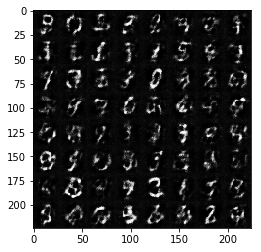

In [ ]:
batch_size = 300
z_dim = 100
learning_rate = 0.0002
beta1 = 0.05


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
print( mnist_dataset.shape)
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

In [ ]:
batch_size = None
z_dim = None
learning_rate = None
beta1 = None


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.